In [1]:
import datasets
import tensorflow as tf
# import numpy as np
# import musdb
# import IPython.display as ipd
# import random
# import gc
# from tqdm import tqdm
# from typing import Union, List, Tuple, Dict

In [2]:
root_mus = '../MUSDB18' # directory containing musdb dataset
num_tracks = 100

params = datasets.DatasetParam(num_songs=num_tracks, num_samples=100, segment=1, repeat=1000)
data = datasets.Dataset(root=root_mus, max_decoded=100)



In [4]:
batches = data.make_dataset(p=params)

Instructions for updating:
Use output_signature instead
Instructions for updating:
Use output_signature instead


In [5]:
batches

<_FlatMapDataset element_spec=(TensorSpec(shape=(200, 1200), dtype=tf.float32, name=None), TensorSpec(shape=(200, 4, 1200), dtype=tf.float32, name=None))>

In [5]:
batches.save('data_v2/tensor_dataset_small_3')

Decoding Audio [90, 82, 45, 93, 73, 58, 41, 39, 71, 85, 32, 69, 79, 72, 22, 84, 20, 49, 50, 60, 57, 53, 56, 81, 87, 77, 59, 61, 54, 67, 19, 16, 0, 15, 8, 14, 11, 91, 10, 3, 9, 47, 12, 31, 36, 92, 38, 66, 6, 86, 98, 44, 95, 23, 74, 27, 17, 1, 26, 18, 29, 37, 83, 96, 33, 24, 46, 76, 28, 64, 70, 97, 35, 68, 2, 40, 34, 13, 94, 63, 42, 5, 99, 25, 48, 30, 75, 7, 89, 52, 65, 43, 55, 21, 78, 51, 88, 4, 62, 80]...


100%|██████████| 100/100 [05:33<00:00,  3.33s/it]


In [7]:
batches = tf.data.Dataset.load(f'data_v2/tensor_dataset_small_')

In [7]:
batches.save('data_v2/tensor_dataset_small')

Decoding Audio [9, 49, 1, 69, 32, 35, 41, 15, 8, 39, 31, 26, 2, 48, 7, 22, 6, 20, 50]...


 42%|████▏     | 8/19 [00:26<00:41,  3.74s/it]

In [13]:
for i,thing in enumerate(batches):
    print(i, len(thing))

Decoding Audio [98, 79, 38, 12, 73, 62, 1, 53, 66, 55, 15, 75, 26, 89, 40, 54, 19, 69]...


 28%|██▊       | 5/18 [00:19<00:48,  3.71s/it]

In [9]:

# Iterate through the dataset and save individual tensors
for i, (tensor1, tensor2) in enumerate(batches):
    save_tensors(tensor1, f'tensors/tensor1_{i}.tfrecord')
    save_tensors(tensor2, f'tensors/tensor2_{i}.tfrecord')

# Save metadata (optional but recommended)
    metadata = {'num_samples': i + 1}  # Save number of samples
    with open('metadata.json', 'w') as f:
        json.dump(metadata, f)



Decoding Audio [59, 65, 89, 54, 7, 11, 96, 5, 37, 81, 47, 45, 22, 21, 93, 18, 44, 69, 67, 68, 31, 8, 99, 70, 74]...


100%|██████████| 25/25 [02:10<00:00,  5.22s/it]


AttributeError: module 'tensorflow._api.v2.io' has no attribute 'write_tensor'

In [ ]:
# To load the dataset later
def load_tensors(filename):
    with tf.io.gfile.GFile(filename, 'rb') as f:
        return tf.io.read_tensor(f)

def load_dataset():
    # Load metadata
    with open('metadata.json', 'r') as f:
        metadata = json.load(f)
    num_samples = metadata['num_samples']

    # Reconstruct dataset
    dataset = tf.data.Dataset.from_tensor_slices((
        [load_tensors(f'tensor1_{i}.tfrecord') for i in range(num_samples)],
        [load_tensors(f'tensor2_{i}.tfrecord') for i in range(num_samples)]
    ))

    return dataset

# Load the dataset
loaded_dataset = load_dataset()

In [3]:
path = '../MUSDB18'
mus = musdb.DB(root=path)
mus[0].audio

array([[1.47705078e-02, 3.02124023e-03],
       [3.26538086e-02, 1.63879395e-02],
       [5.39550781e-02, 3.79028320e-02],
       ...,
       [0.00000000e+00, 0.00000000e+00],
       [3.05175781e-05, 0.00000000e+00],
       [0.00000000e+00, 0.00000000e+00]])

In [7]:
track = librosa.to_mono(mus[0].audio.T)
ipd.display(ipd.Audio(track, rate=mus[0].rate))

In [9]:
import numpy as np
import librosa
def normalize_array(arr):
    mean = np.mean(arr)
    std = np.std(arr)
    normalized_arr = (arr - mean) / std
    return normalized_arr


In [17]:
np.mean(norm_track)

-2.2446689634144402e-17

In [10]:
norm_track = normalize_array(track)
ipd.display(ipd.Audio(norm_track, rate=mus[0].rate))

c:\Users\cobyw\anaconda3\Lib\site-packages\IPython\core\events.py:93: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)
c:\Users\cobyw\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


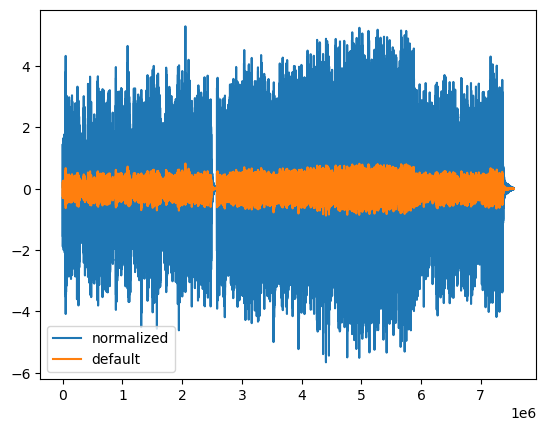

In [13]:
import matplotlib.pyplot as plt

plt.plot(norm_track, label="normalized")
plt.plot(track, label='default')
plt.legend()

In [10]:
track.targets["vocals"].audio

array([[-2.98156738e-02, -4.23278809e-02],
       [-3.78417969e-02, -5.35583496e-02],
       [-3.32336426e-02, -4.68444824e-02],
       ...,
       [ 0.00000000e+00,  3.05175781e-05],
       [ 9.15527344e-05,  1.22070312e-04],
       [-3.35693359e-04, -3.05175781e-04]])